# Audio with Python - the basics
source: https://realpython.com/playing-and-recording-sound-python/

## Contents
0. Display audio with IPython
1. Python's built in 'wave'
2. Winsound
3. Playsound
4. Simpleaudio
5. Creating a wav file with numpy
6. Pyaudio
7. Sounddevice (record .wav files)
8. Pysoundfile

### TO DO
- [] Playsound - The specified device is not open or is not recognized by MCI.
- [] Pyaudio - get stream working

## 0. Display audio with IPython

In [34]:
pwd

'/Users/michielbontenbal/Documents/GitHub/Notebooks'

In [32]:
#show all .wav files in current folder
from glob import glob
wav_files = glob('*.wav')
print(wav_files)

['my-audio.wav', 'new_file.wav', 'out.wav', 'file.wav', 'loudness.wav', 'test2.wav', 'claxon_iphone.wav', 'test3.wav', 'my_wav.wav', 'mywav_reduced_noise2.wav', 'Yoda.wav', 'piano_c.wav', 'claxon_michiel.wav', 'claxon_close.wav', 'miaow_16k.wav', 'tone_220.wav', 'welcome.wav', 'silence.wav', 'example.wav', '11k16bitpcm.wav', 'claxon_freesound.wav', 'robot0.wav', 'my_test.wav', 'converted.wav', 'speech_whistling2.wav', 'robot1.wav', 'mywav_reduced_noise.wav', 'robot3.wav', 'test.wav', 'noise_add.wav', 'converted2.wav', 'robot2.wav', 'Sample_audio.wav', 'tone_440.wav', 'claxon_1m.wav', 'output.wav']


In [33]:
#most simple
import IPython
IPython.display.Audio('tone_220.wav')

The IPython.display.Audio(...) command only creates a "display" object (in that particular case, an object of the subclass Audio of the class DisplayObject).

Afterwards, you may do basic actions with such an object, tied to the class DisplayObject (and specific stuff tied to the class Audio). One of those actions consists of displaying it, by using the IPython.display.display function.

If you want to display multiple audio files you can do:

In [37]:
#multiple audio files
import IPython
print(wav_files[0])
IPython.display.display(IPython.display.Audio(wav_files[0]))
print(wav_files[1])
IPython.display.display(IPython.display.Audio(wav_files[1]))
print(wav_files[2])
IPython.display.display(IPython.display.Audio(wav_files[2]))

my-audio.wav


new_file.wav


out.wav


In [41]:
cd oe_wavs

/Users/michielbontenbal/Documents/GitHub/Notebooks/oe_wavs


In [42]:
from glob import glob
wav_files = glob('*.wav')

In [43]:
#using a for loop for all audio files

#multiple audio files
import IPython
i=0
for i in range(len(wav_files)):
    print(wav_files[i])
    IPython.display.display(IPython.display.Audio(wav_files[i]))
    i+1


record_1630520911.wav


new_file.wav


record_1630521211.wav


record_1630521001.wav


record_1630521271.wav


record_1630520971.wav


record_1630521061.wav


record_1630521091.wav


record_1630520761.wav


record_1630520941.wav


record_1630520821.wav


record_1630521121.wav


record_1630521241.wav


record_1630521151.wav


record_1630521031.wav


record_1630520851.wav


record_1630520881.wav


record_1630521181.wav


## 1. Python's built in 'wave'

In [2]:
import wave
filename = wave.open('test.wav')
params = wave.Wave_read.getparams(filename)
print(params)#prints a tuple

_wave_params(nchannels=1, sampwidth=1, framerate=8000, nframes=54000, comptype='NONE', compname='not compressed')


## 2. Python's built in winsound

In [3]:
#winsound is a built in function dat creates a beep with a certain frequency.
import winsound
winsound.Beep(1000, 100)  # Beep at 1000 Hz for 100 ms. Only works with integers!

In [4]:
# note ladder
#source: https://pages.mtu.edu/~suits/notefreqs.html
#C4	261.63
#D4	293.66 
#E4	329.63
#F4	349.23
#G4	392.00
#A4	440.00
#B4	493.88
#C5 523
my_freqs =[261, 293, 330, 349, 392, 440, 494, 523]
for i in range(len(my_freqs)):
    winsound.Beep(my_freqs[i], 500)

## 3. Playsound
Simple library to play audio files

In [10]:
!pip install playsound

  Created wheel for playsound: filename=playsound-1.3.0-py3-none-any.whl size=7035 sha256=441554429bf5c0aa2cdf261826b1933dbe3f85d8542e33a9b0a77f9c372257c0
  Stored in directory: c:\users\michiel\appdata\local\pip\cache\wheels\ba\39\54\c8f7ff9a88a644d3c58b4dec802d90b79a2e0fb2a6b884bf82
Successfully built playsound


In [8]:
from glob import glob
my_mp3s= glob('*.mp3')
my_mp3s

['razorback (1).mp3', 'razorback.mp3', 'temp.mp3', 'welcome.mp3']

In [9]:
#Play an audiofile with one line of code! Can't stop the music. 
from playsound import playsound
playsound('welcome.mp3')


    Error 263 for command:
        open welcome.mp3
    The specified device is not open or is not recognized by MCI.

    Error 263 for command:
        close welcome.mp3
    The specified device is not open or is not recognized by MCI.
Failed to close the file: welcome.mp3


PlaysoundException: 
    Error 263 for command:
        open welcome.mp3
    The specified device is not open or is not recognized by MCI.

## 4. Simpleaudio - play (only) wav files


In [13]:
!pip install simpleaudio

  Created wheel for simpleaudio: filename=simpleaudio-1.0.4-cp39-cp39-win_amd64.whl size=2039219 sha256=6ed9eb6ae6306211d59becc0342239ff4a1c91661ba6b19d34a5f1b34a2bd07d
  Stored in directory: c:\users\michiel\appdata\local\pip\cache\wheels\9e\98\21\6774fbadaeb379c6823dacb09d41a7b5057d72f6f732897358
Successfully built simpleaudio


In [10]:
# simple script to play a .wav file
import simpleaudio as sa

filename = 'out.wav' #mijn hallo 
wave_obj = sa.WaveObject.from_wave_file(filename)
play_obj = wave_obj.play()
play_obj.wait_done()  # Wait until sound has finished playing

## 5. Pysoundfile
http://pysoundfile.readthedocs.org/.

SoundFile can read and write sound files.
SoundFile is an audio library based on libsndfile, CFFI and NumPy. 

It's a very handy package to inspect .wav files, for example

In [18]:
!pip install pysoundfile

In [23]:
print(wav_files)

['11k16bitpcm.wav', 'claxon_1m.wav', 'claxon_close.wav', 'claxon_freesound.wav', 'claxon_iphone.wav', 'claxon_michiel.wav', 'converted.wav', 'example.wav', 'file.wav', 'loudness.wav', 'miaow_16k.wav', 'my-audio.wav', 'my_test.wav', 'my_wav.wav', 'noise_add.wav', 'out.wav', 'output.wav', 'piano_c.wav', 'robot0.wav', 'robot1.wav', 'robot2.wav', 'robot3.wav', 'silence.wav', 'speech_whistling2.wav', 'test.wav', 'test2.wav', 'test3.wav', 'tone_220.wav', 'welcome.wav']


In [11]:
#write a .wav file to a new filename
import soundfile as sf

data, samplerate = sf.read('piano_c.wav')
sf.write('new_file.wav', data, samplerate)

### 5b. Inspecting a wav file

In [10]:
cd oe_wavs

/Users/michielbontenbal/Documents/GitHub/Notebooks/oe_wavs


In [11]:
ls

new_file.wav           record_1630520941.wav  record_1630521121.wav
record_1630520761.wav  record_1630520971.wav  record_1630521151.wav
record_1630520821.wav  record_1630521001.wav  record_1630521181.wav
record_1630520851.wav  record_1630521031.wav  record_1630521211.wav
record_1630520881.wav  record_1630521061.wav  record_1630521241.wav
record_1630520911.wav  record_1630521091.wav  record_1630521271.wav


In [12]:
import soundfile as sf
file = sf.SoundFile('record_1630520761.wav')
len(file), file.channels, file.samplerate

(480000, 1, 16000)

In [26]:
from glob import glob
import IPython

my_wavs = glob('*.wav')
x= my_wavs[1]

IPython.display.Audio(x)

In [16]:
file.format, file.subtype, file.endian

('WAV', 'PCM_16', 'FILE')

In [17]:
test = file.read()
test.shape

(0,)

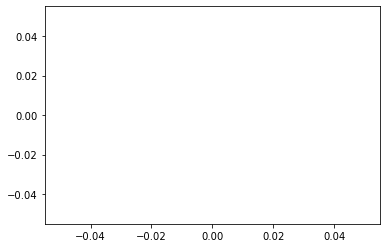

In [18]:
import matplotlib.pyplot as plt
plt.plot(test)

## 7. Pyaudio
source: https://realpython.com/playing-and-recording-sound-python/

Install with 'conda install pyaudio' or see this post: https://stackoverflow.com/questions/65276020/i-am-using-python-3-9-and-i-cant-figure-out-how-to-install-pyaudio-in-my-window

In [28]:
import glob
my_wavs = glob.glob('*.wav')
print(my_wavs)

['11k16bitpcm.wav', 'claxon_1m.wav', 'claxon_close.wav', 'claxon_freesound.wav', 'claxon_iphone.wav', 'claxon_michiel.wav', 'converted.wav', 'example.wav', 'file.wav', 'loudness.wav', 'miaow_16k.wav', 'my-audio.wav', 'my_test.wav', 'my_wav.wav', 'new_file.wav', 'noise_add.wav', 'out.wav', 'output.wav', 'piano_c.wav', 'robot0.wav', 'robot1.wav', 'robot2.wav', 'robot3.wav', 'silence.wav', 'speech_whistling2.wav', 'test.wav', 'test2.wav', 'test3.wav', 'tone_220.wav', 'welcome.wav']


In [1]:
#NOT WORKING PROPERLY - NEED TO FIX PYAUDIO STREAM
import pyaudio
import wave

filename = 'example.wav'

# Set chunk size of 1024 samples per data frame
chunk = 1024  

# Open the sound file with built in module p
wf = wave.open(filename, 'rb')

# Create an interface to PortAudio
p = pyaudio.PyAudio()

# Open a .Stream object to write the WAV file to
# 'output = True' indicates that the sound will be played rather than recorded
stream = p.open(format = p.get_format_from_width(wf.getsampwidth()),
                channels = wf.getnchannels(),
                rate = wf.getframerate(),
                output = True)

# Read data in chunks
data = wf.readframes(chunk)

# Play the sound by writing the audio data to the stream
while data != '':
    stream.write(data)
    data = wf.readframes(chunk)

# Close and terminate the stream
stream.close()
p.terminate()

KeyboardInterrupt: 

In [39]:
help(stream)

Help on Stream in module pyaudio object:

class Stream(builtins.object)
 |  Stream(PA_manager, rate, channels, format, input=False, output=False, input_device_index=None, output_device_index=None, frames_per_buffer=1024, start=True, input_host_api_specific_stream_info=None, output_host_api_specific_stream_info=None, stream_callback=None)
 |  
 |  PortAudio Stream Wrapper. Use :py:func:`PyAudio.open` to make a new
 |  :py:class:`Stream`.
 |  
 |  **Opening and Closing**
 |    :py:func:`__init__`, :py:func:`close`
 |  
 |  **Stream Info**
 |    :py:func:`get_input_latency`, :py:func:`get_output_latency`,
 |    :py:func:`get_time`, :py:func:`get_cpu_load`
 |  
 |  **Stream Management**
 |    :py:func:`start_stream`, :py:func:`stop_stream`, :py:func:`is_active`,
 |    :py:func:`is_stopped`
 |  
 |  **Input Output**
 |    :py:func:`write`, :py:func:`read`, :py:func:`get_read_available`,
 |    :py:func:`get_write_available`
 |  
 |  Methods defined here:
 |  
 |  __init__(self, PA_manager, r

## 8. Sounddevice (record .wav files)
source: https://realpython.com/playing-and-recording-sound-python/#recording-audio
source: https://python-sounddevice.readthedocs.io/en/latest/

In [31]:
!pip install sounddevice

In [32]:
import sounddevice as sd
from scipy.io.wavfile import write

fs = 16000  # Sample rate
seconds = 10  # Duration of recording

myrecording = sd.rec(int(seconds * fs), samplerate=fs, channels=2)
sd.wait()  # Wait until recording is finished
write('robot3.wav', fs, myrecording)  # Save as WAV file 

In [34]:
import glob
wav_files = glob.glob('*.wav')
print(wav_files)

['11k16bitpcm.wav', 'claxon_1m.wav', 'claxon_close.wav', 'claxon_freesound.wav', 'claxon_iphone.wav', 'claxon_michiel.wav', 'converted.wav', 'example.wav', 'file.wav', 'loudness.wav', 'miaow_16k.wav', 'my-audio.wav', 'my_test.wav', 'my_wav.wav', 'new_file.wav', 'noise_add.wav', 'out.wav', 'output.wav', 'piano_c.wav', 'robot0.wav', 'robot1.wav', 'robot2.wav', 'robot3.wav', 'silence.wav', 'speech_whistling2.wav', 'test.wav', 'test2.wav', 'test3.wav', 'tone_220.wav', 'welcome.wav']


In [35]:
from IPython import display
display.Audio('my_test.wav')